In [20]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
fatal: destination path 'detectron2' already exists and is not an empty directory.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [21]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [22]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode, Visualizer
from detectron2 import model_zoo

import cv2
import numpy
import matplotlib.pyplot as plt
from pprint import pprint

from google.colab.patches import cv2_imshow

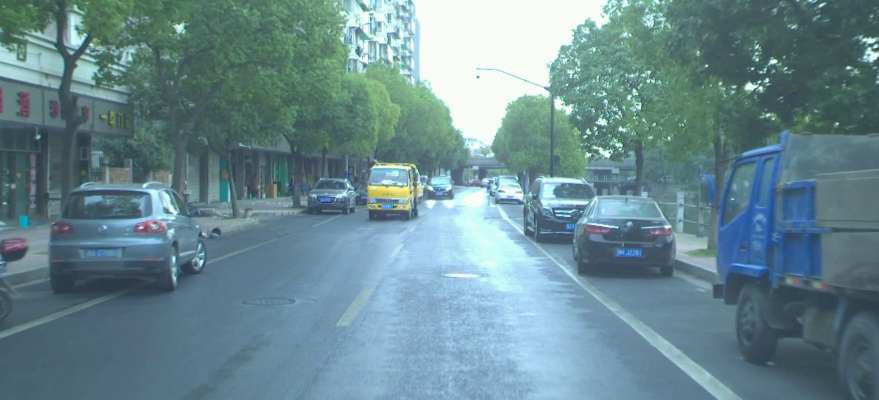

In [23]:
image = cv2.imread('image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg')
cv2_imshow(image)

In [24]:
cfg = get_cfg()
cfg.MODEL.DEVICE = "cpu"

cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")

panoptic segmentations


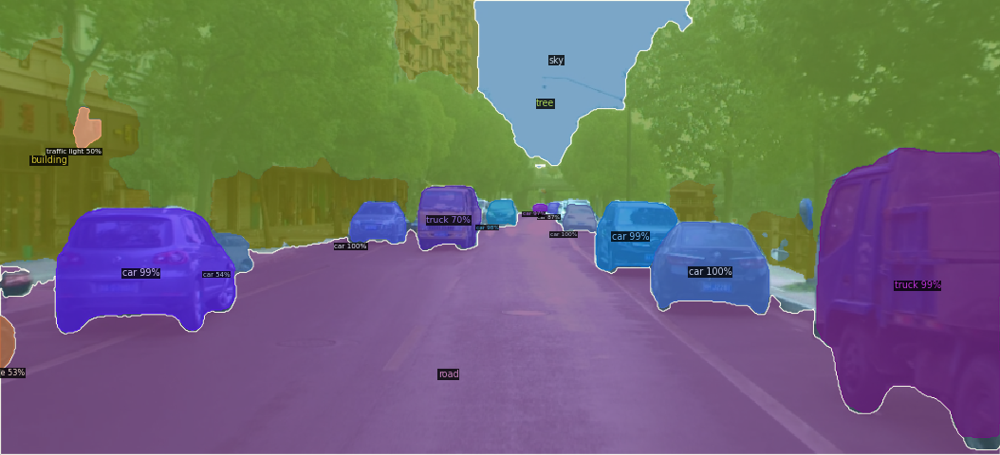

instance predictions


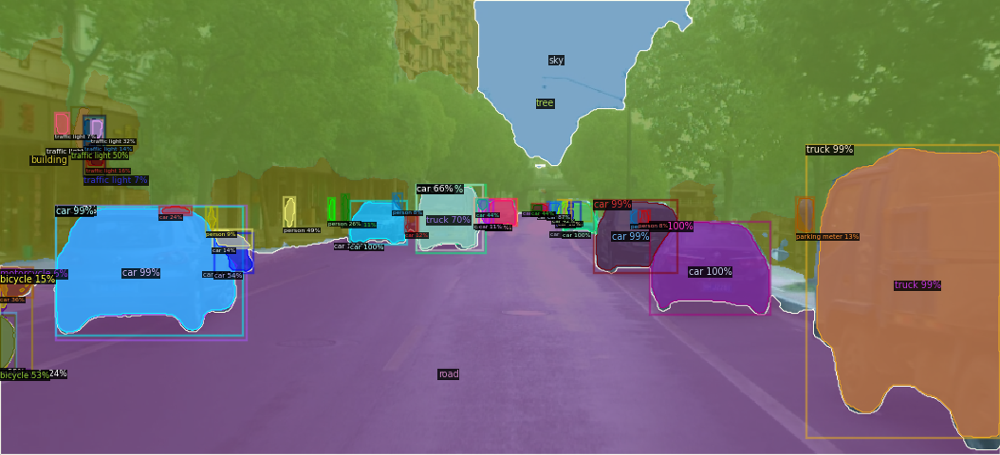

(tensor([[15, 15, 15,  ..., 15, 15, 15],
         [15, 15, 15,  ..., 15, 15, 15],
         [15, 15, 15,  ..., 15, 15, 15],
         ...,
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14],
         [14, 14, 14,  ..., 14, 14, 14]], dtype=torch.int32),
 [{'id': 1,
   'isthing': True,
   'score': 0.9977814555168152,
   'category_id': 2,
   'instance_id': 0,
   'area': 6561.0},
  {'id': 2,
   'isthing': True,
   'score': 0.9959344863891602,
   'category_id': 2,
   'instance_id': 1,
   'area': 1477.0},
  {'id': 3,
   'isthing': True,
   'score': 0.9950982928276062,
   'category_id': 2,
   'instance_id': 2,
   'area': 594.0},
  {'id': 4,
   'isthing': True,
   'score': 0.9900480508804321,
   'category_id': 2,
   'instance_id': 3,
   'area': 3336.0},
  {'id': 5,
   'isthing': True,
   'score': 0.9876614809036255,
   'category_id': 2,
   'instance_id': 4,
   'area': 13658.0},
  {'id': 6,
   'isthing': True,
   'score': 0.9854550361633301,
   'category_id': 7,
   '

In [25]:
predictor = DefaultPredictor(cfg)

def panoptic_and_instance_segmentation(image):
  panoptic_seg, segments_info = predictor(image)["panoptic_seg"]

  v = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  print('panoptic segmentations')
  out = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
  cv2_imshow(out.get_image()[:, :, ::-1])

  print('instance predictions')
  out = v.draw_instance_predictions(predictor(image)["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

  return panoptic_seg, segments_info

panoptic_and_instance_segmentation(image)

contour :  0
mask


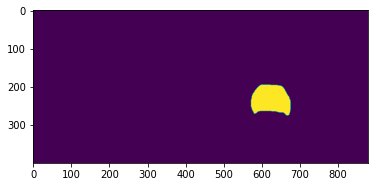

contour :  1
mask


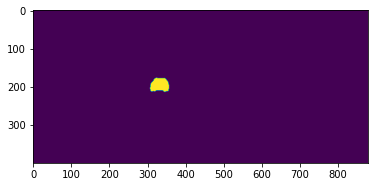

contour :  2
mask


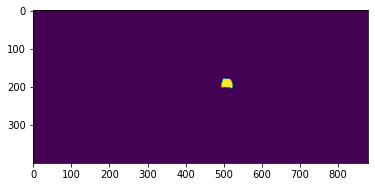

contour :  3
mask


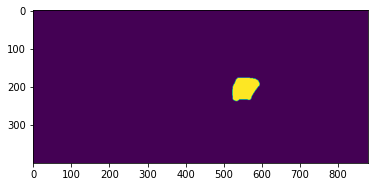

contour :  4
mask


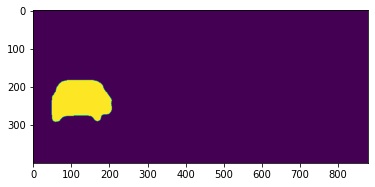

contour :  5
mask


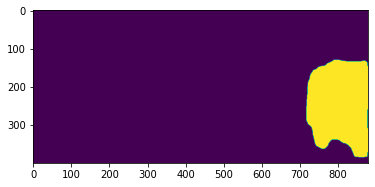

contour :  6
mask


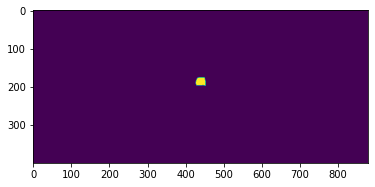

contour :  7
mask


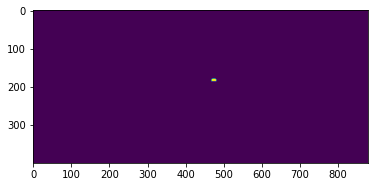

contour :  8
mask


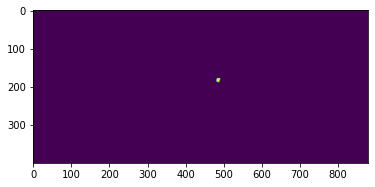

contour :  9
mask


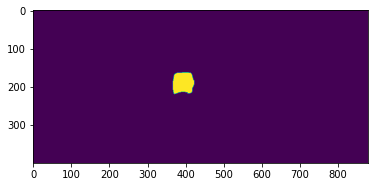

contour :  10
mask


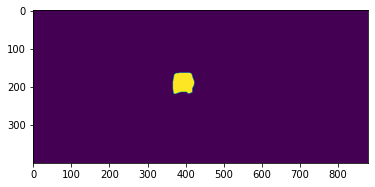

contour :  11
mask


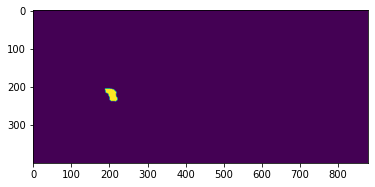

contour :  12
mask


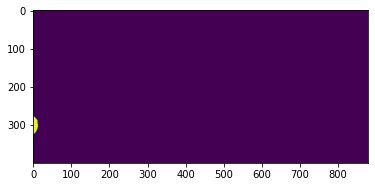

contour :  13
mask


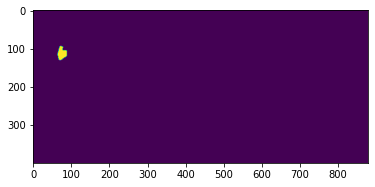

contour :  14
mask


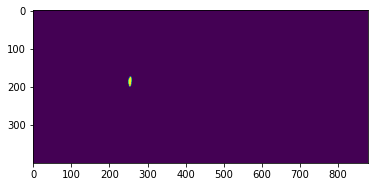

contour :  15
mask


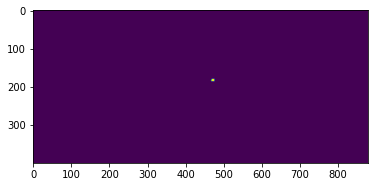

contour :  16
mask


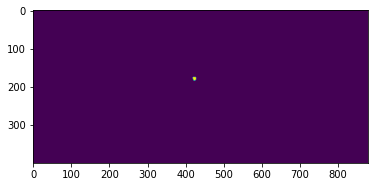

contour :  17
mask


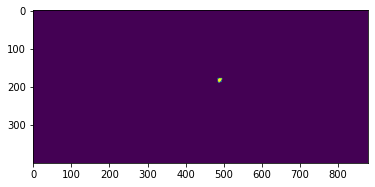

contour :  18
mask


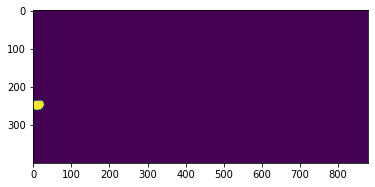

contour :  19
mask


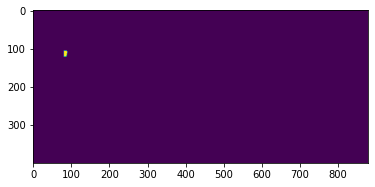

contour :  20
mask


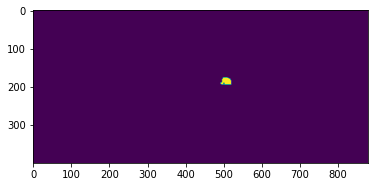

contour :  21
mask


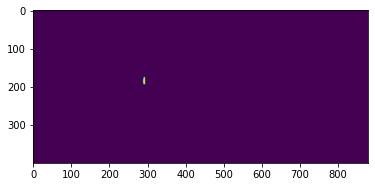

contour :  22
mask


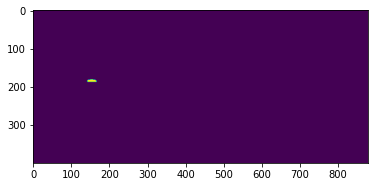

contour :  23
mask


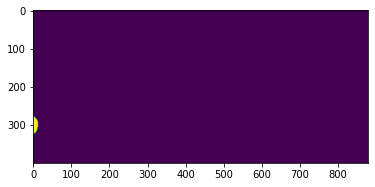

contour :  24
mask


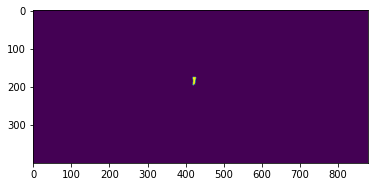

contour :  25
mask


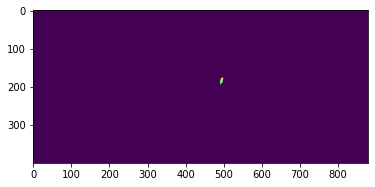

contour :  26
mask


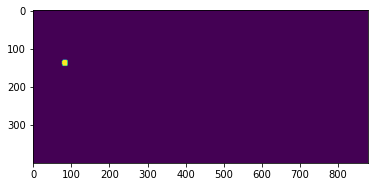

contour :  27
mask


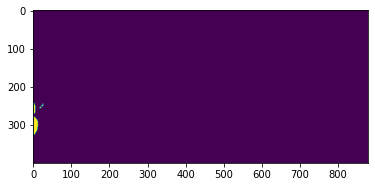

contour :  28
mask


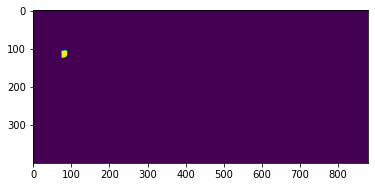

contour :  29
mask


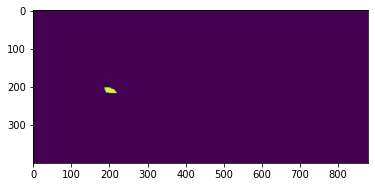

contour :  30
mask


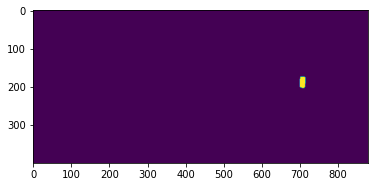

contour :  31
mask


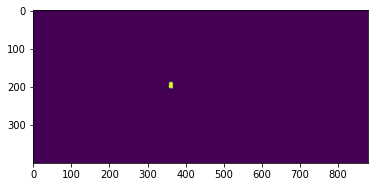

contour :  32
mask


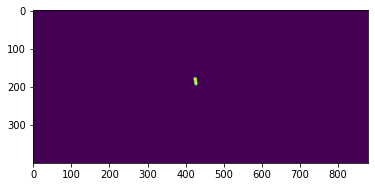

contour :  33
mask


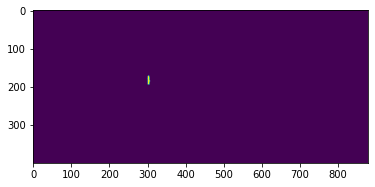

contour :  34
mask


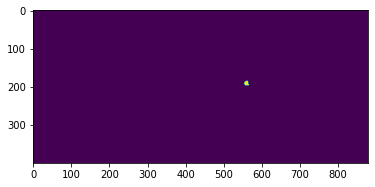

contour :  35
mask


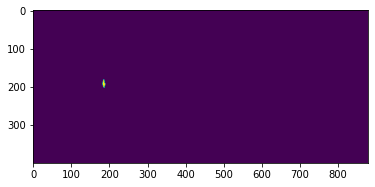

contour :  36
mask


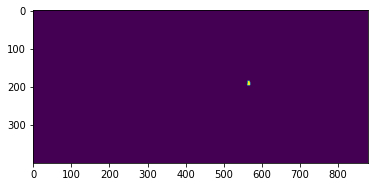

contour :  37
mask


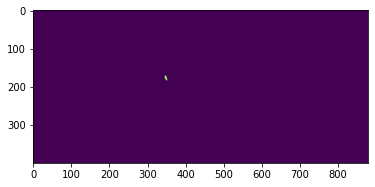

contour :  38
mask


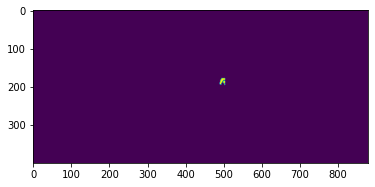

contour :  39
mask


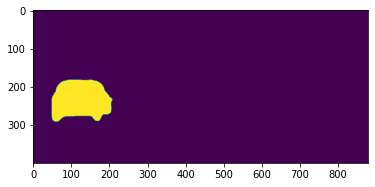

contour :  40
mask


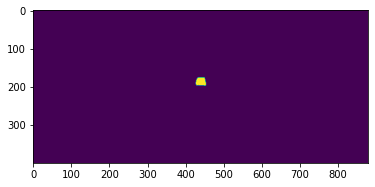

contour :  41
mask


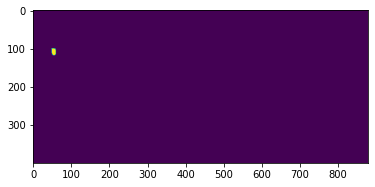

contour :  42
mask


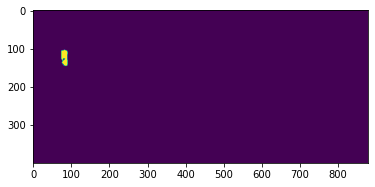

contour :  43
mask


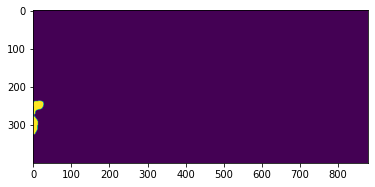

[array([[[599, 195]],
 
        [[598, 196]],
 
        [[597, 196]],
 
        [[596, 196]],
 
        [[595, 197]],
 
        [[594, 198]],
 
        [[593, 198]],
 
        [[592, 199]],
 
        [[591, 200]],
 
        [[590, 201]],
 
        [[589, 202]],
 
        [[588, 203]],
 
        [[587, 204]],
 
        [[586, 205]],
 
        [[586, 206]],
 
        [[585, 207]],
 
        [[584, 208]],
 
        [[583, 209]],
 
        [[582, 210]],
 
        [[582, 211]],
 
        [[581, 212]],
 
        [[581, 213]],
 
        [[580, 214]],
 
        [[579, 215]],
 
        [[578, 216]],
 
        [[578, 217]],
 
        [[577, 218]],
 
        [[577, 219]],
 
        [[576, 220]],
 
        [[575, 221]],
 
        [[575, 222]],
 
        [[575, 223]],
 
        [[575, 224]],
 
        [[574, 225]],
 
        [[574, 226]],
 
        [[574, 227]],
 
        [[574, 228]],
 
        [[574, 229]],
 
        [[573, 230]],
 
        [[573, 231]],
 
        [[573, 232]],
 
        [[573, 2

In [26]:
def get_countours(image, show_mask):
  i = 0
  contours = []
  for pred_mask in predictor(image)['instances'].pred_masks:
      mask = pred_mask.to("cpu").numpy().astype('uint8')
      if show_mask:
        print('contour : ', i)
        print('mask')
        plt.imshow(mask)
        plt.show()
      contour, _ = cv2.findContours(mask, cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
      i += 1
      contours.append(contour[0])
  return contours
get_countours(image, True) 

Instance 0


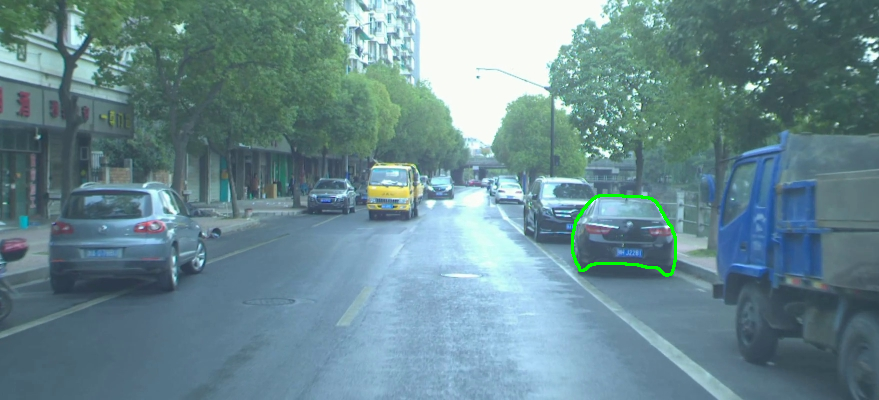

Instance 1


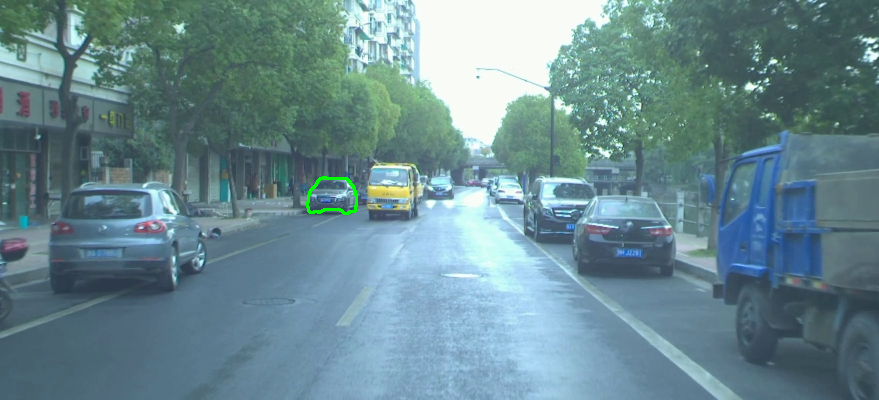

Instance 2


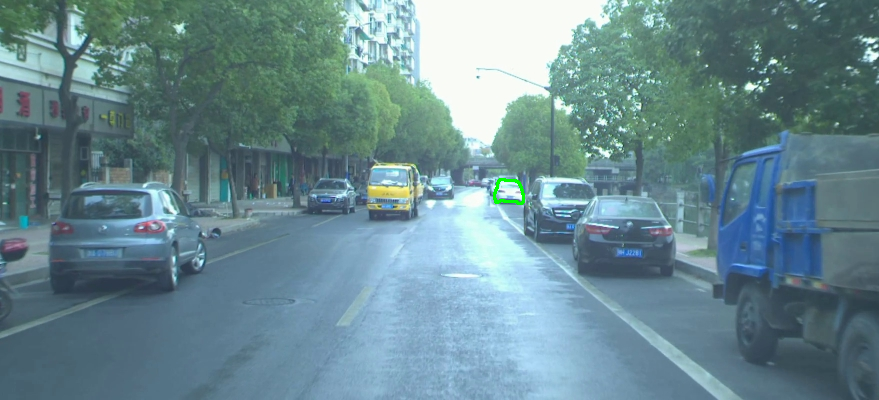

Instance 3


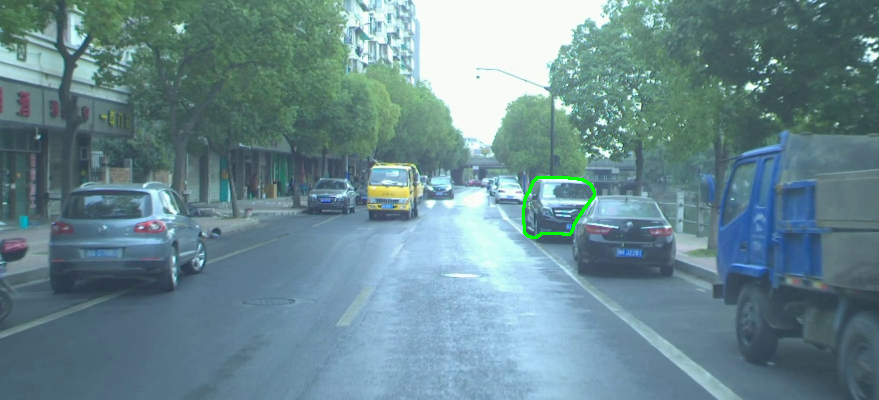

Instance 4


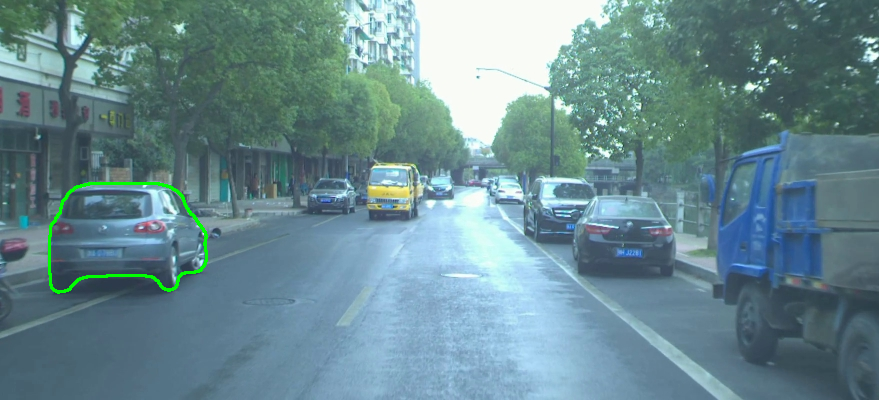

Instance 5


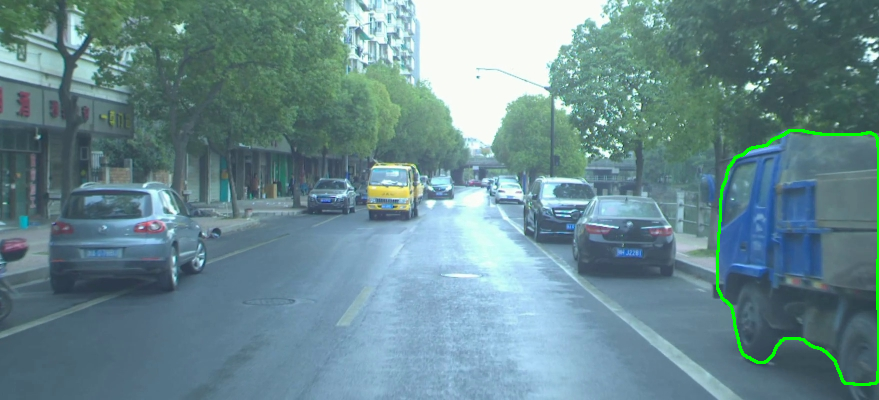

Instance 6


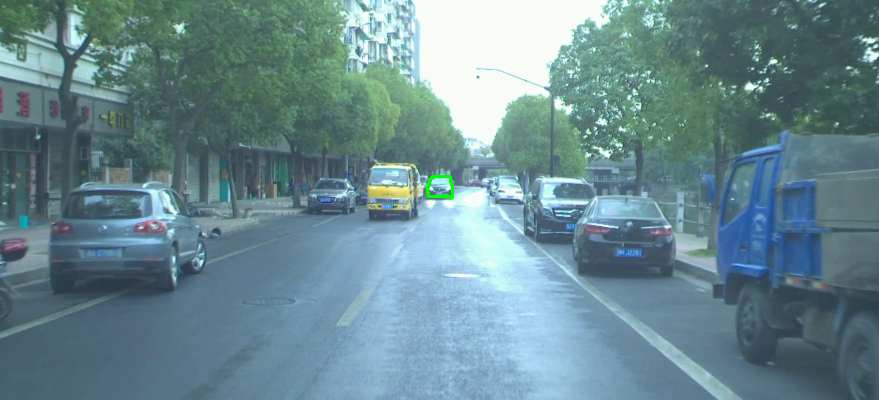

Instance 7


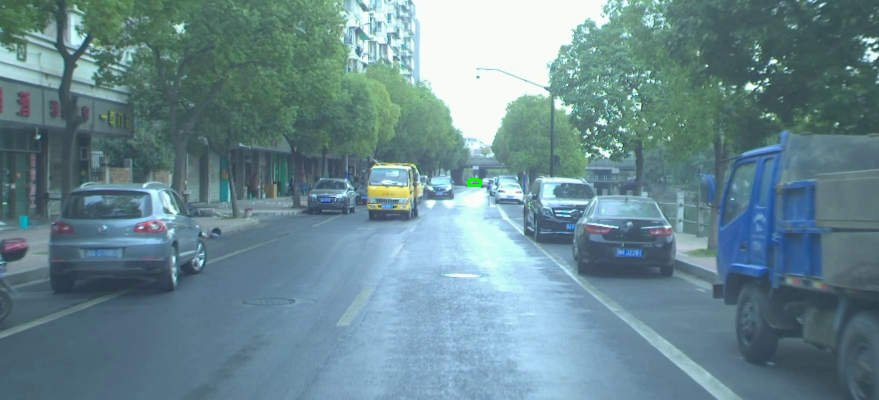

Instance 8


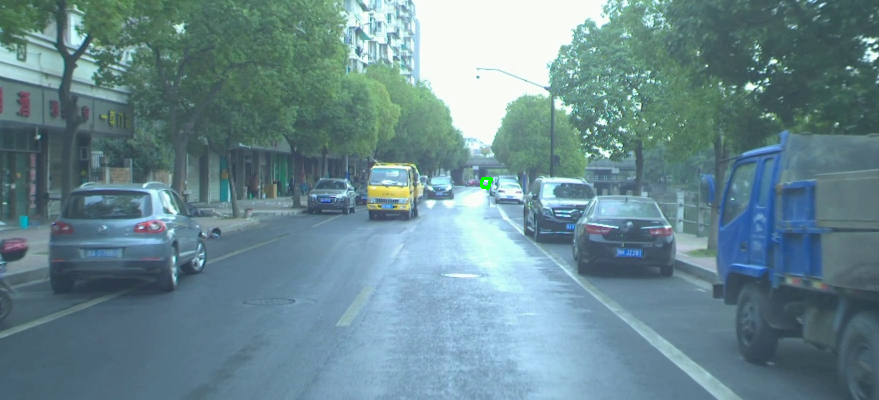

Instance 9


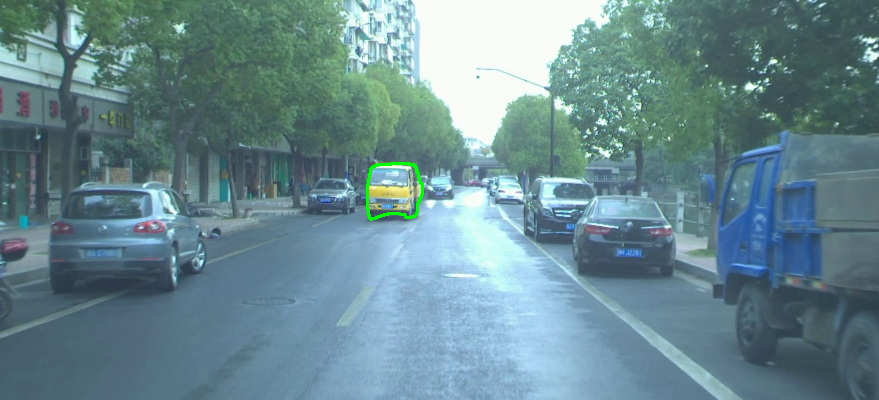

Instance 10


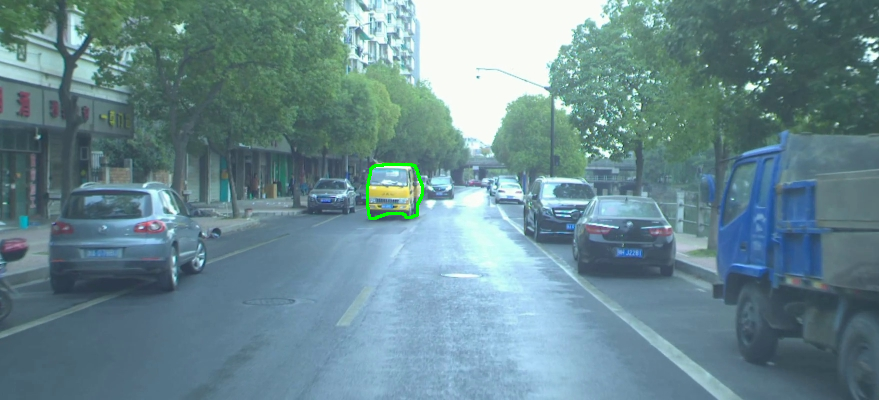

Instance 11


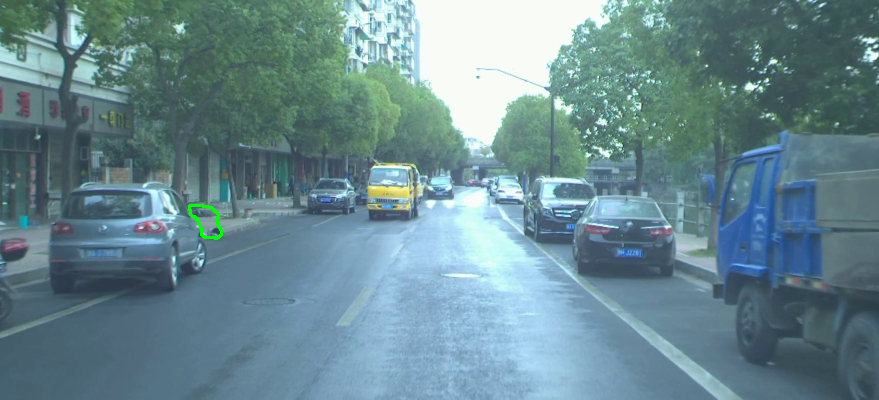

Instance 12


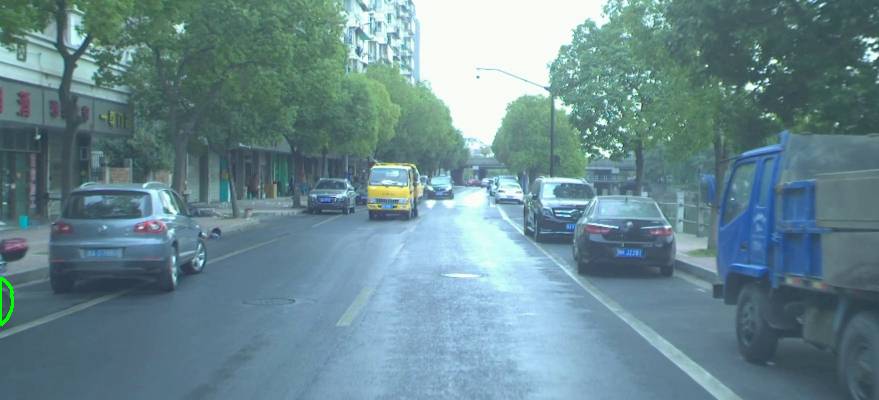

Instance 13


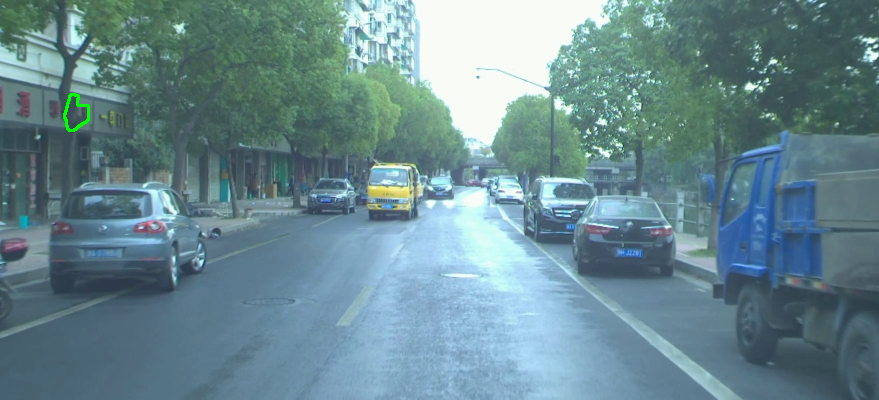

Instance 14


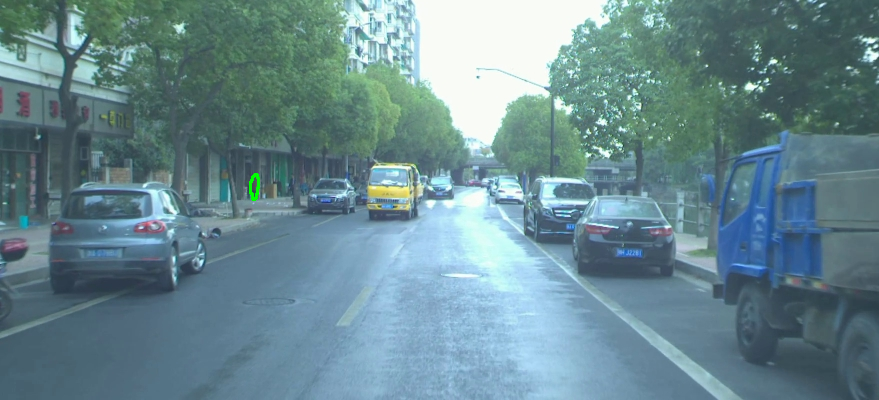

Instance 15


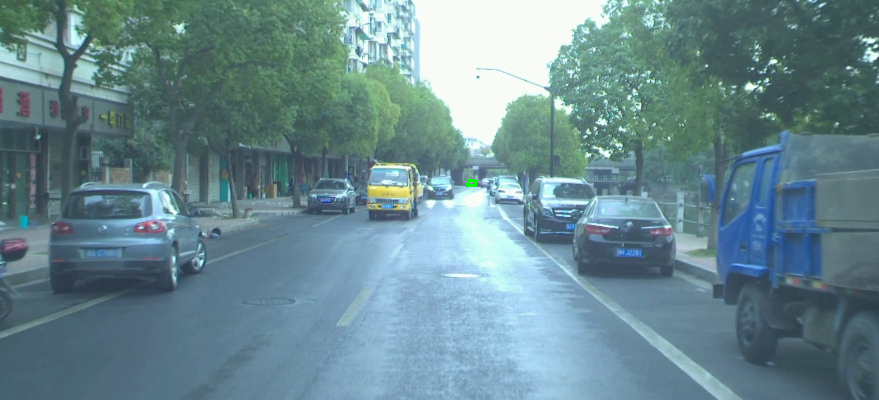

Instance 16


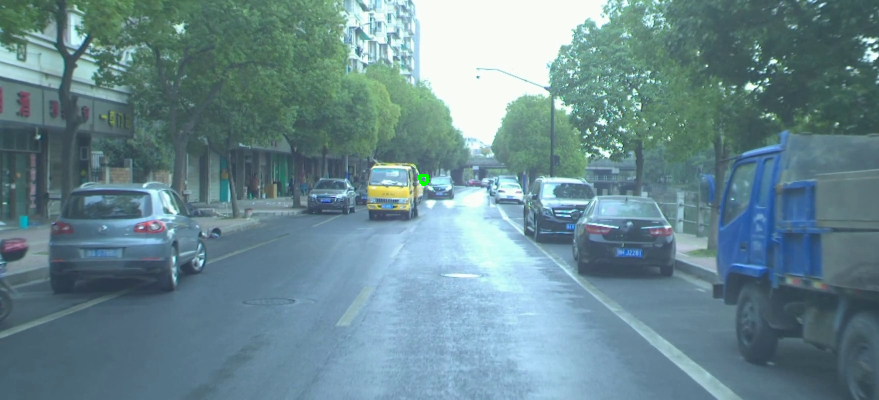

Instance 17


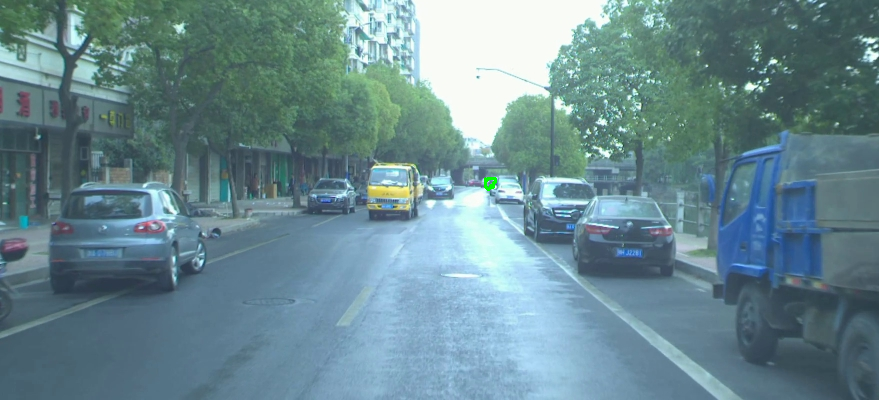

Instance 18


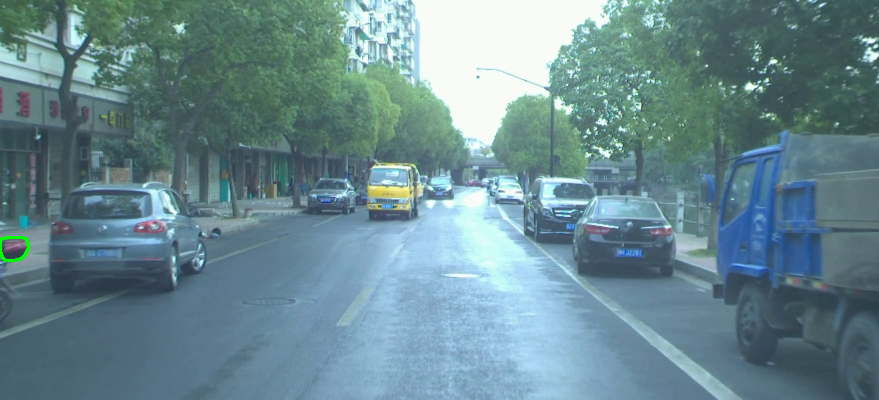

Instance 19


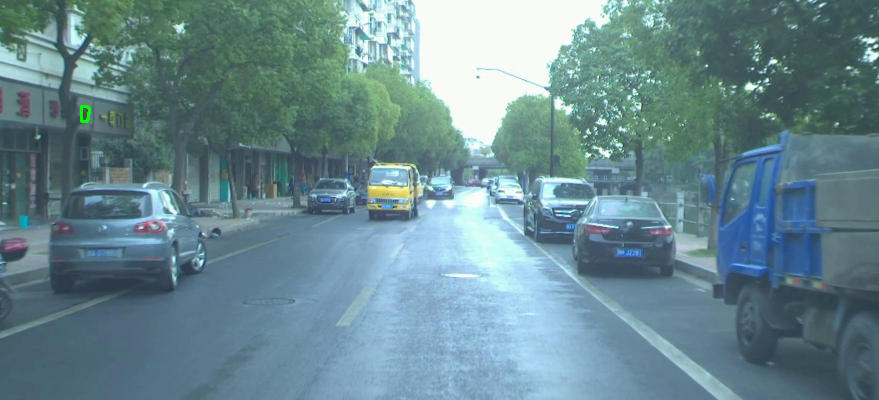

Instance 20


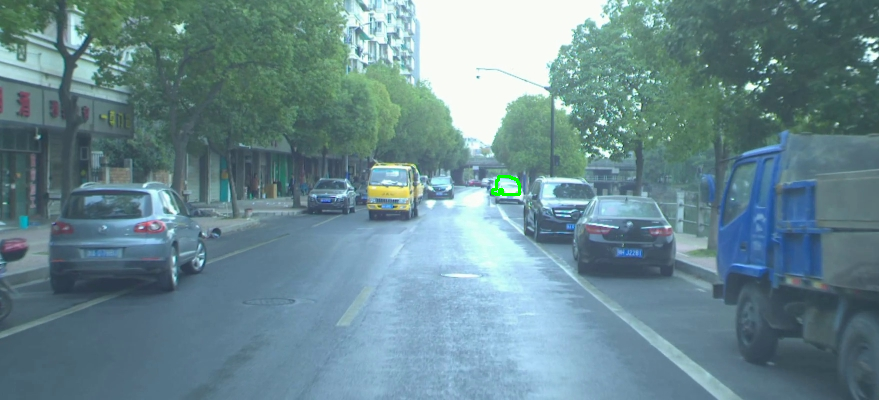

Instance 21


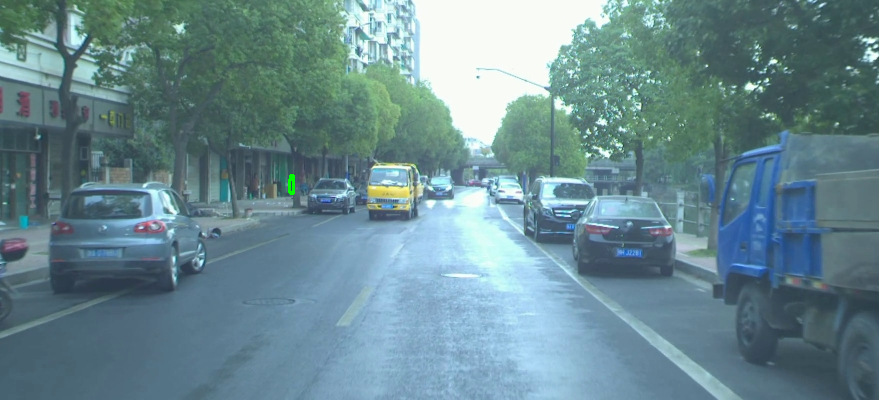

Instance 22


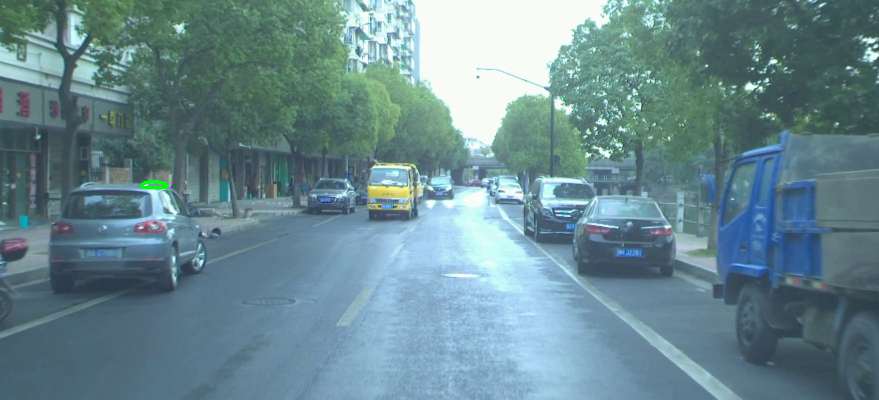

Instance 23


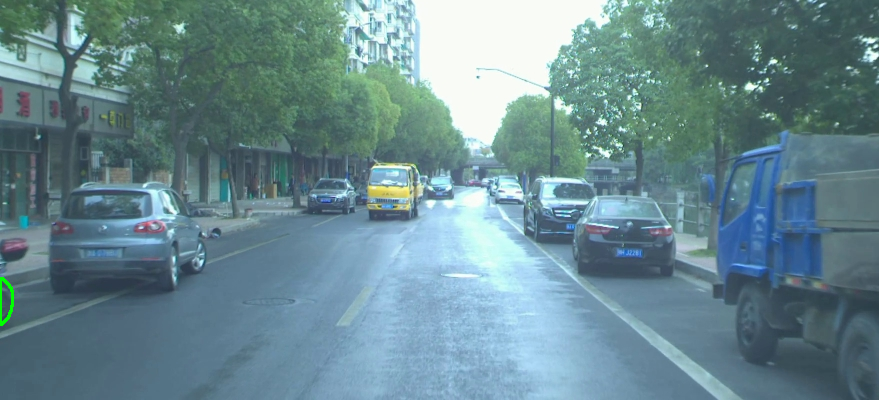

Instance 24


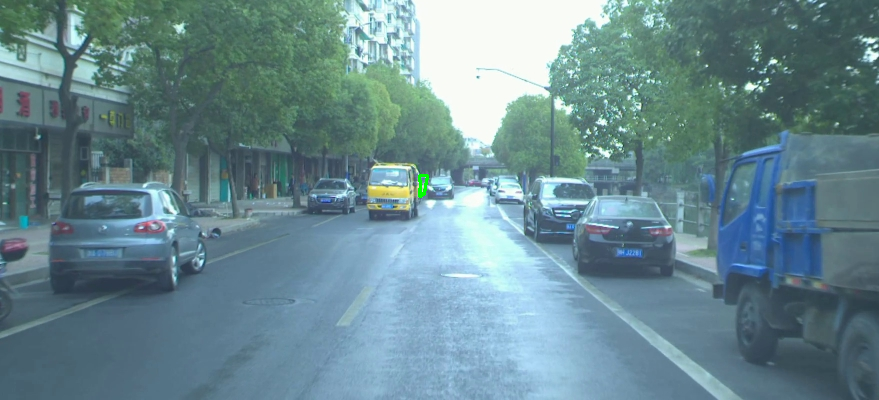

Instance 25


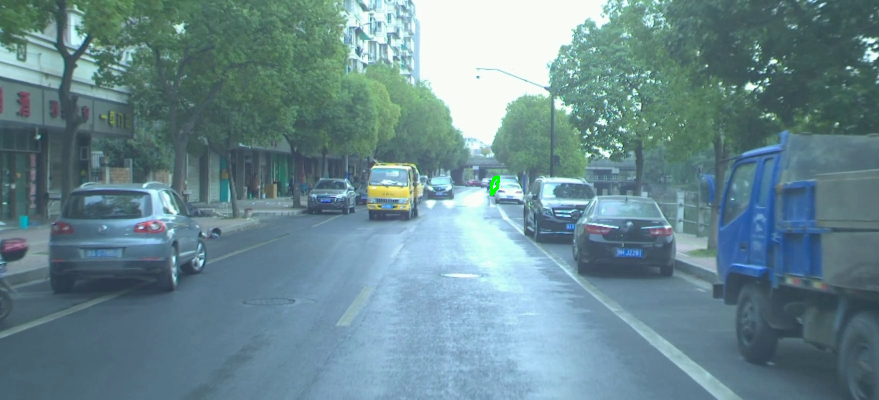

Instance 26


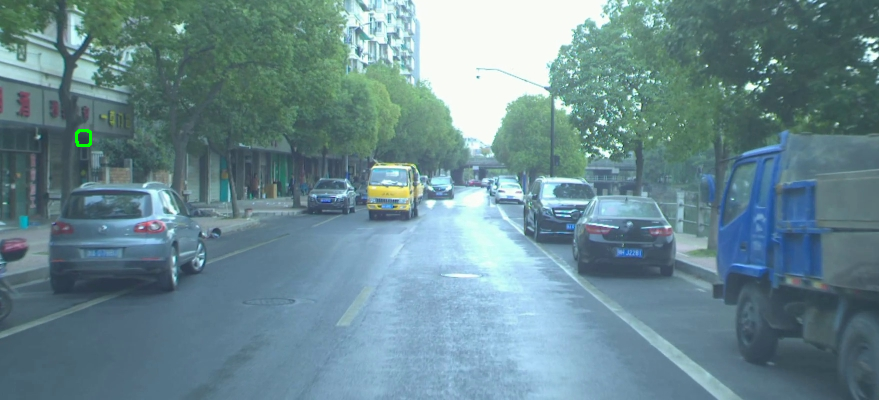

Instance 27


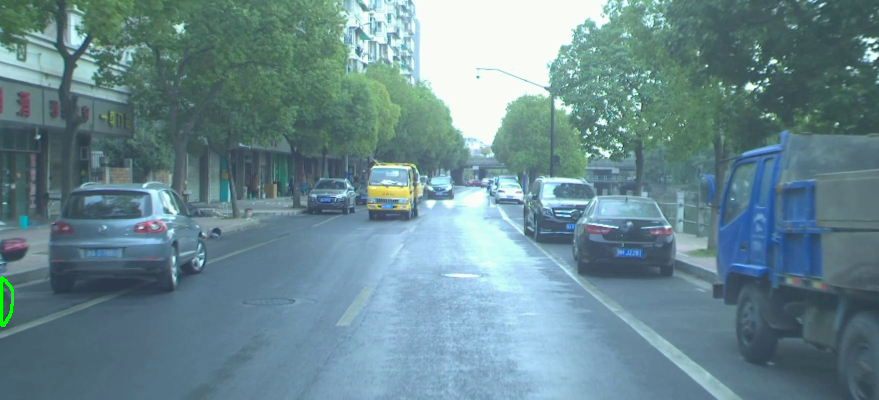

Instance 28


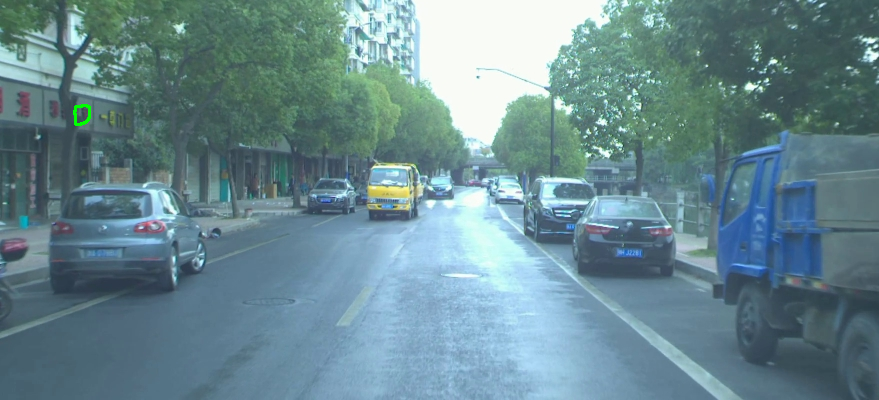

Instance 29


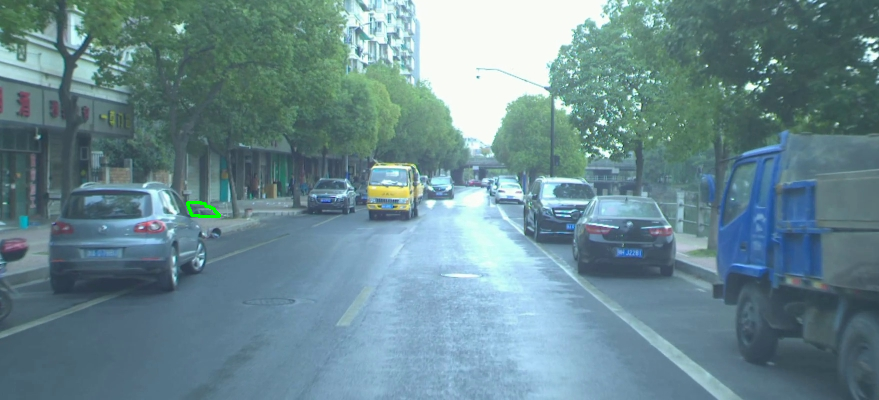

Instance 30


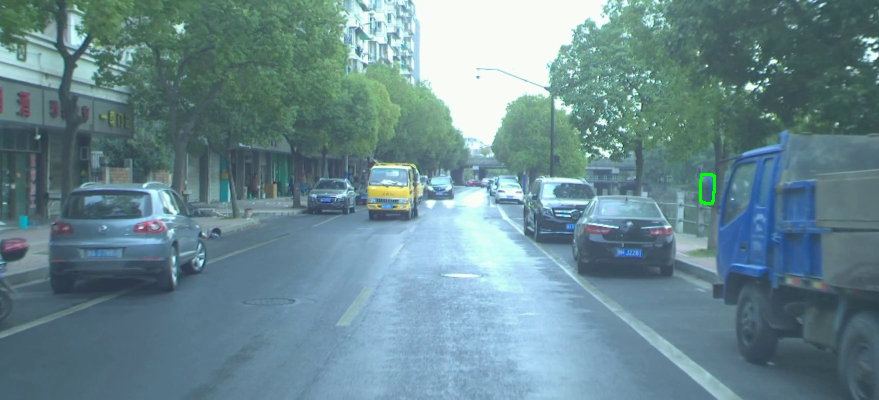

Instance 31


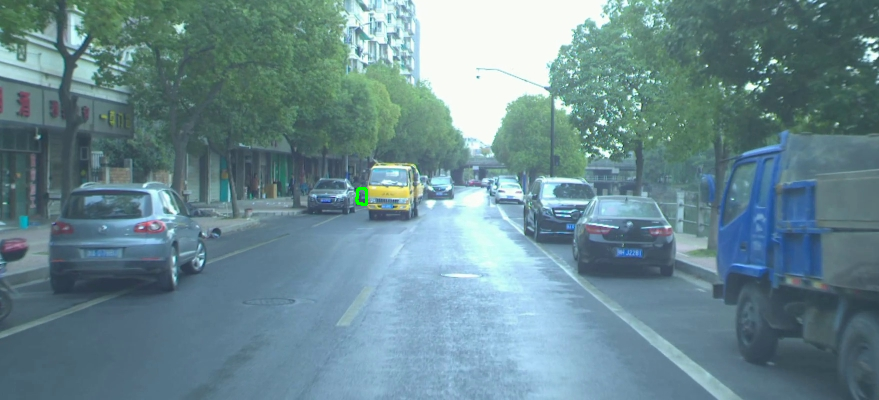

Instance 32


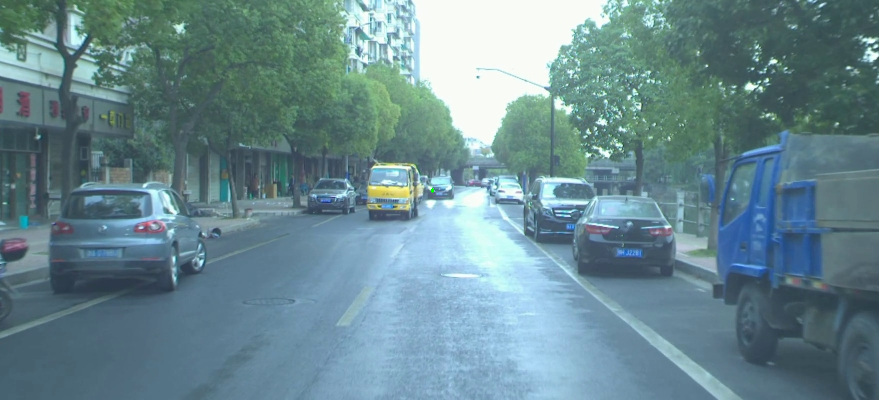

Instance 33


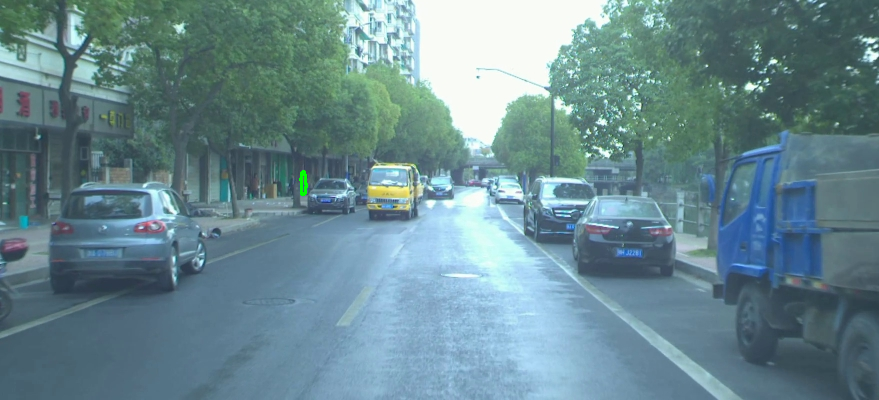

Instance 34


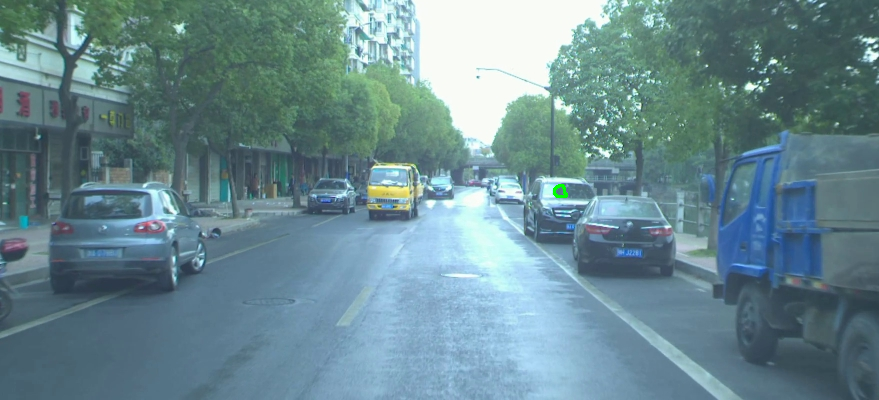

Instance 35


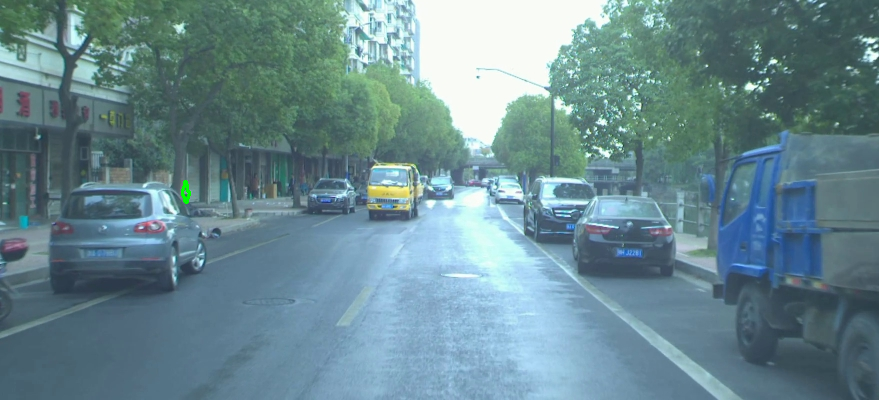

Instance 36


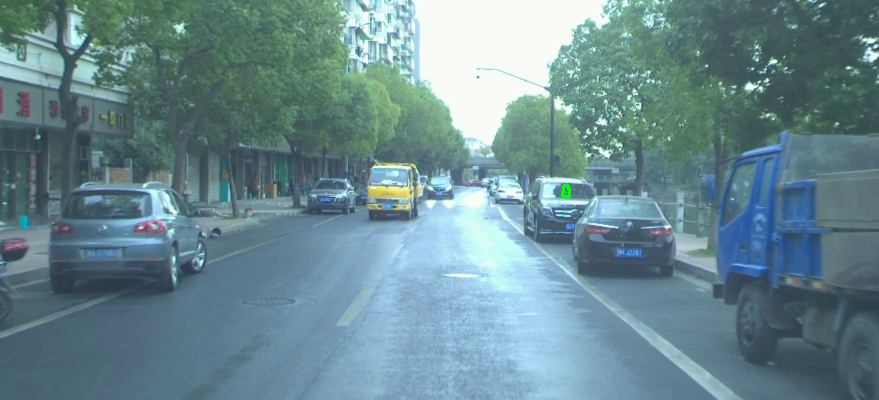

Instance 37


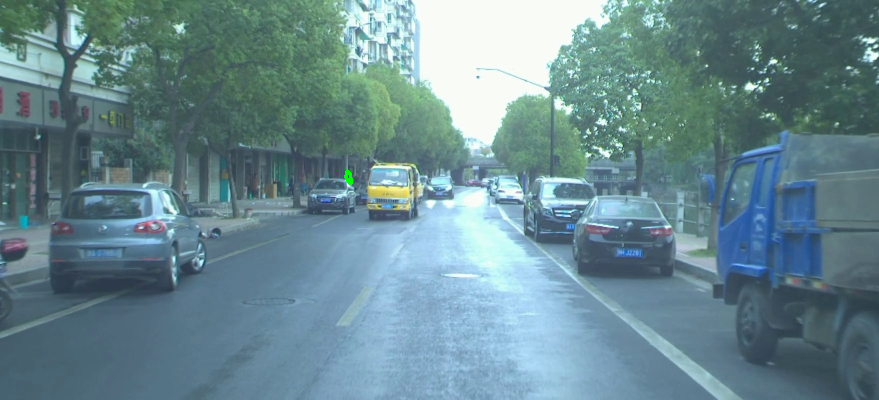

Instance 38


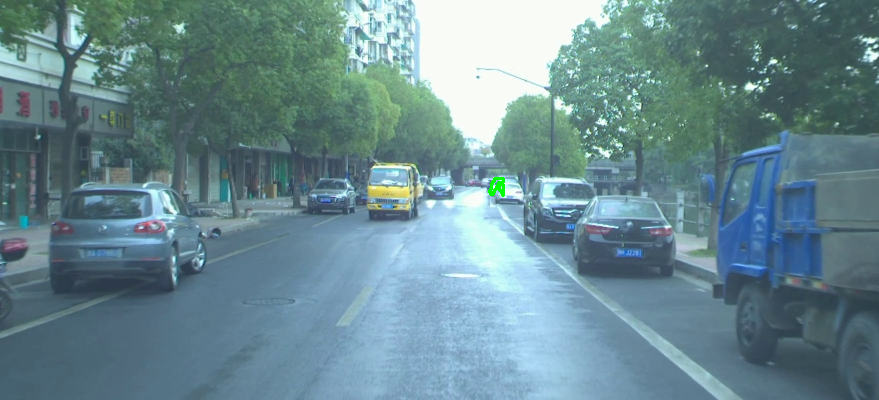

Instance 39


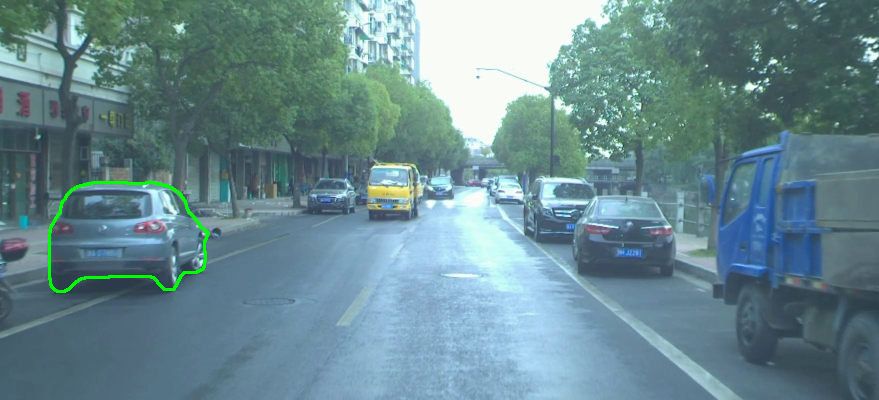

Instance 40


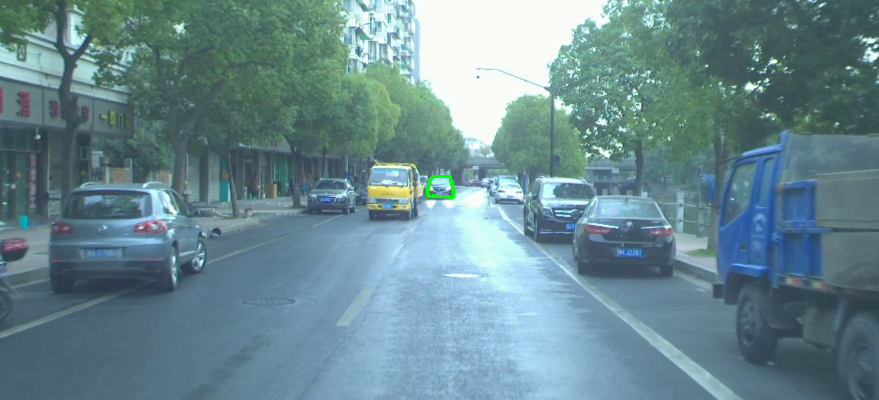

Instance 41


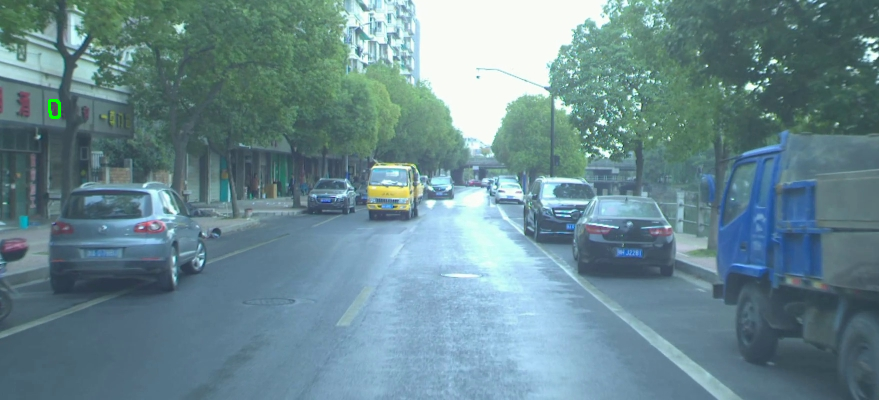

Instance 42


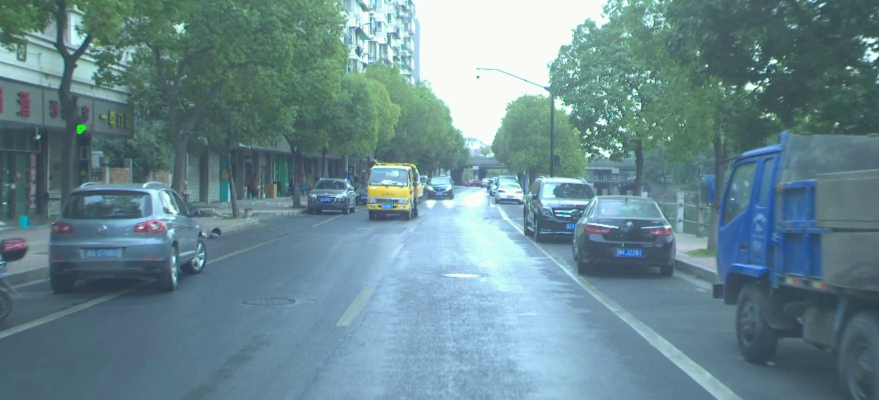

Instance 43


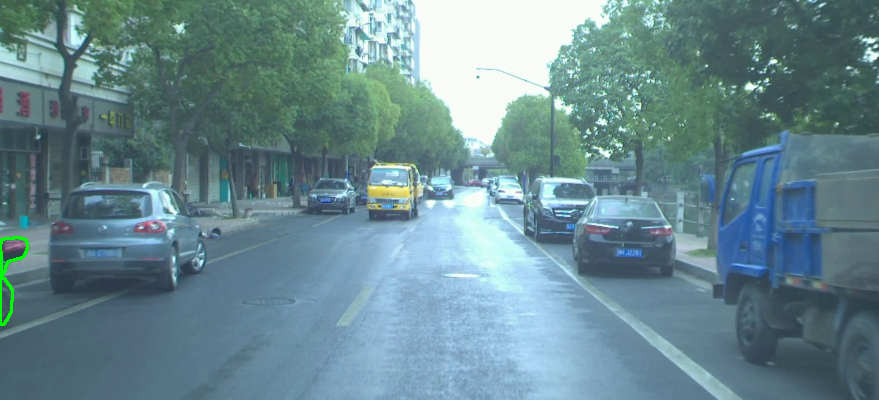

In [27]:
i = 0
contours = get_countours(image, False)
for contour in contours:
    print('Instance', i)
    i = i + 1
    image_with_overlaid_predictions = image.copy()
    cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

def show_contour_at_i(image, contours, i):
  countour = contours[i]
  image_with_overlaid_predictions = image.copy()
  cv2_imshow(cv2.drawContours(image_with_overlaid_predictions, [contour], -1, (0,255, 0), 2))

yellow truck binary mask


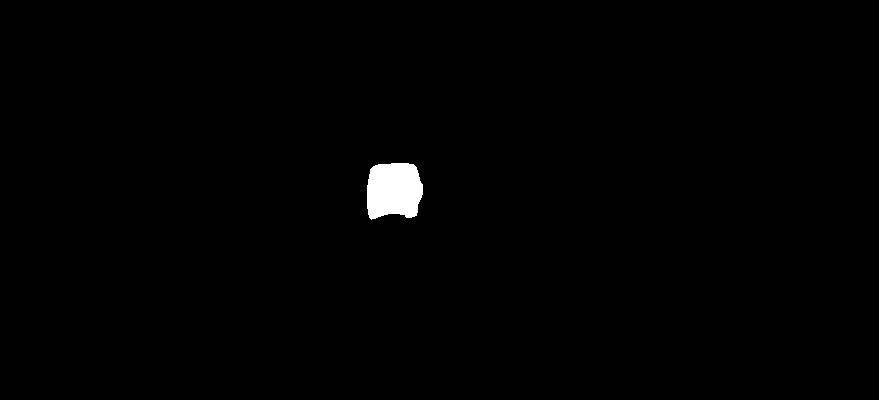

In [28]:
def get_mask_at_i(image, i):
  # Get the binary mask.
  segment = numpy.array(predictor(image)['instances'].pred_masks[i].to("cpu")).astype(numpy.uint8)
  h, w = segment.shape
  mask = numpy.zeros((h, w), dtype=numpy.uint8) + segment

  for i in range(h):
    for j in range(w):
      if mask[i][j] == 1:
        mask[i][j] = 255

  return mask

print('yellow truck binary mask')
cv2_imshow(get_mask_at_i(image, 9))

mask = get_mask_at_i(image, 9)

Extract boundaries (If the mask is A, Boundary extraction : A - (A (-) S), where S is a standard structural element.

boundaries


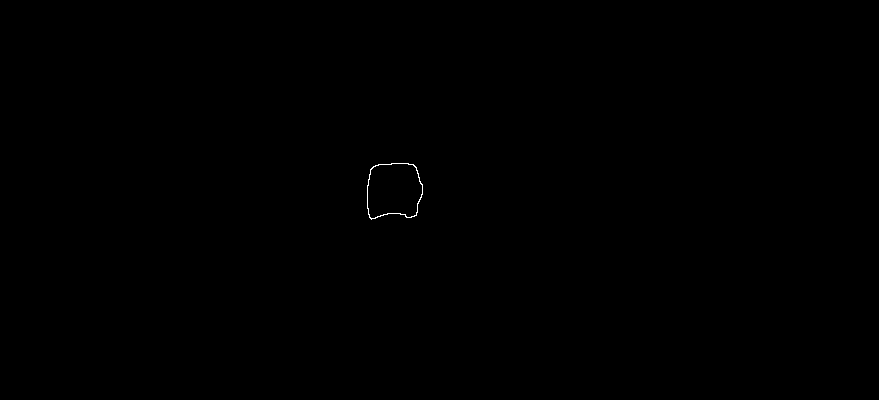

In [29]:
se = numpy.ones((3, 3), dtype=numpy.uint8)
eroded_mask = cv2.erode(mask, se)

boundaries = mask - eroded_mask
print('boundaries')
cv2_imshow(boundaries)

Signature


centroid


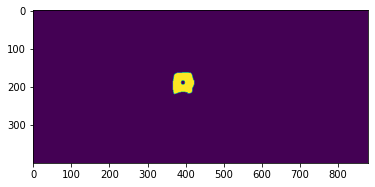

393 189


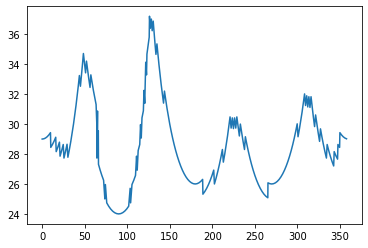

In [30]:
def calculate_signature(mask, boundary, contour):
  m = cv2.moments(contour)
 
  c_x = int(m["m10"] / m["m00"])
  c_y = int(m["m01"] / m["m00"])

  print('centroid')
  plt.imshow(cv2.circle(mask, (c_x, c_y), 5, (0, 0, 0), -1))
  plt.show()

  print(c_x, c_y)
  # Convert all points to a array sorted in anticlockwise order using polar coordinates.
  angles_with_dist = []
  for i in range(boundary.shape[0]):
    for j in range(boundary.shape[1]):
      if (boundary[i][j] == 255):
        cartesian_coords = [i, j]
        dist_to_center = numpy.sqrt((c_x - j) * (c_x - j) + (c_y - i) * (c_y - i))
        _x = j - c_x
        _y = i - c_y

        angle = numpy.arctan2([_y], [_x]) * 180 / numpy.pi
        if angle < 0:
          angle += 360

        angles_with_dist.append((angle, dist_to_center))
  angles_with_dist.sort(key=lambda x: x[0])

  angles = []
  dists = []

  for ad in angles_with_dist:
    angles.append((ad[1]))
    dists.append(ad[0])

  plt.plot(dists, angles)
  plt.show()

calculate_signature(mask, boundaries, contours[9])

image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg


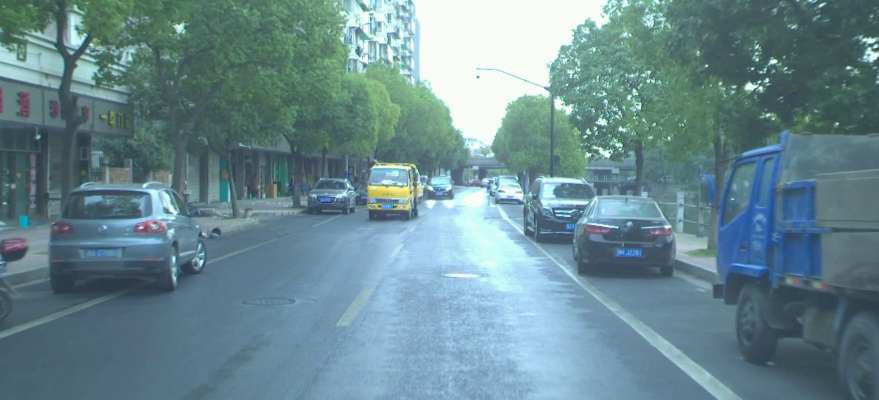

panoptic segmentations


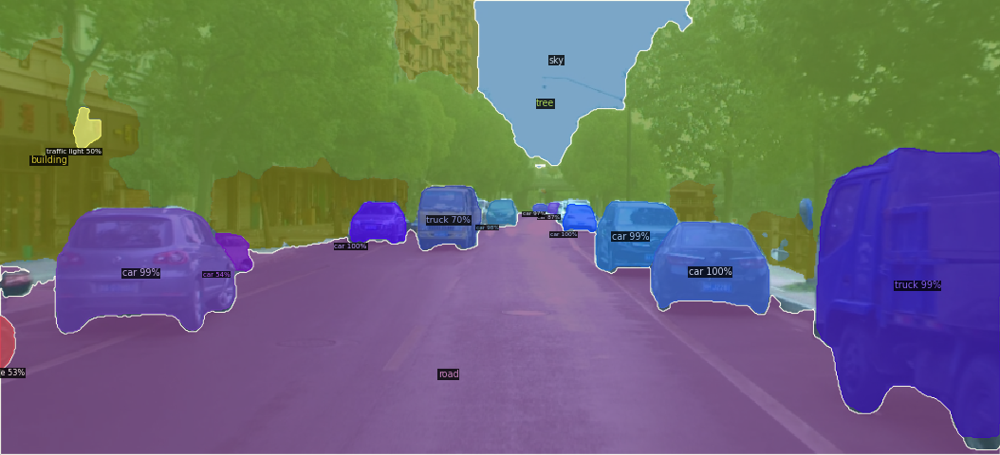

instance predictions


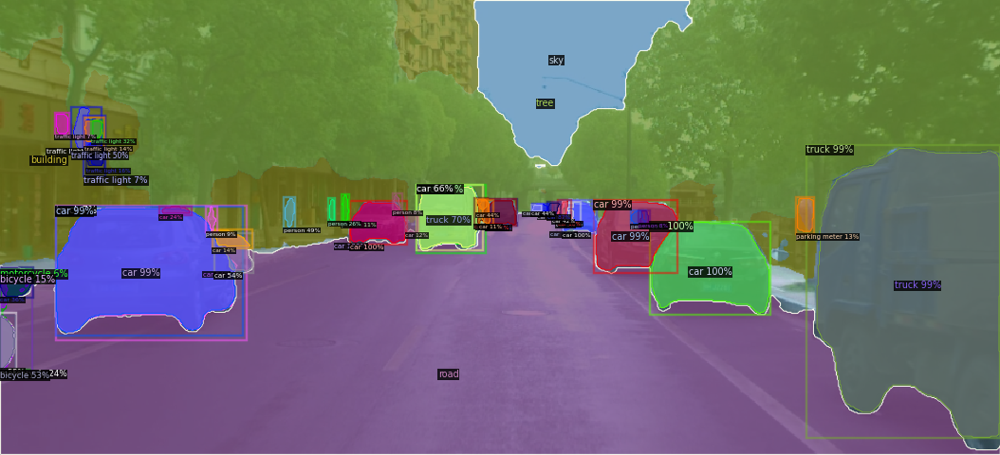

image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg
boundaries


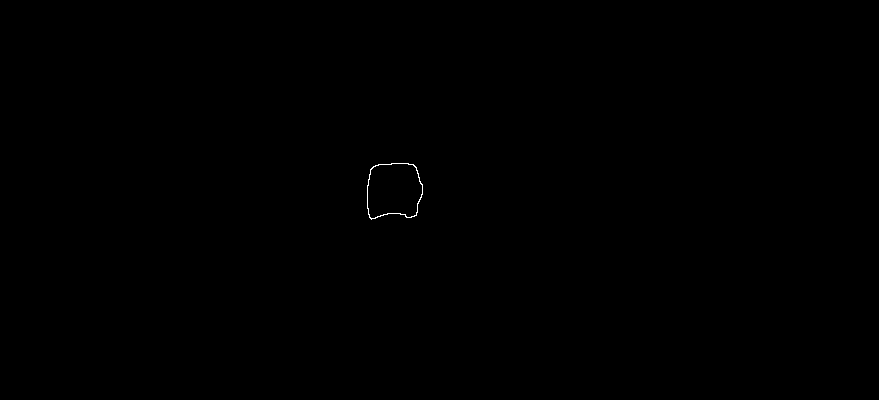

signature
centroid


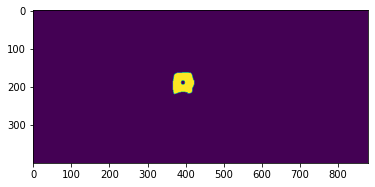

393 189


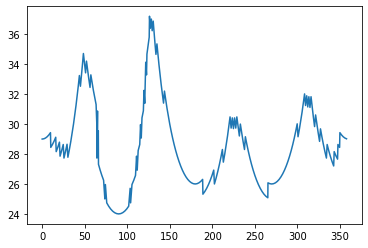

image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg


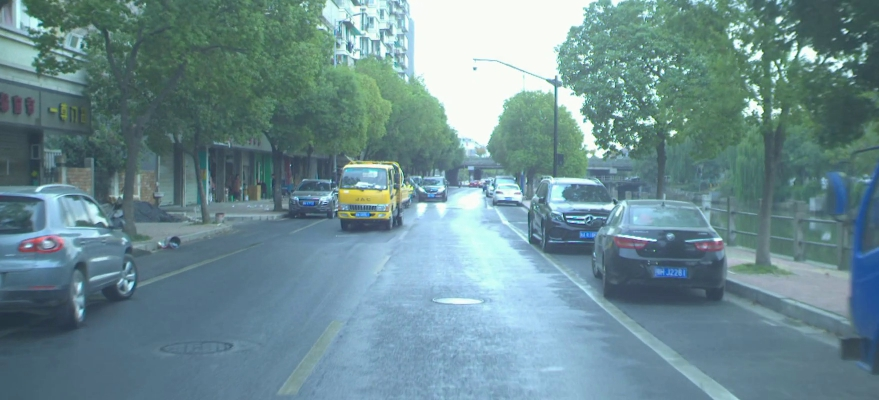

panoptic segmentations


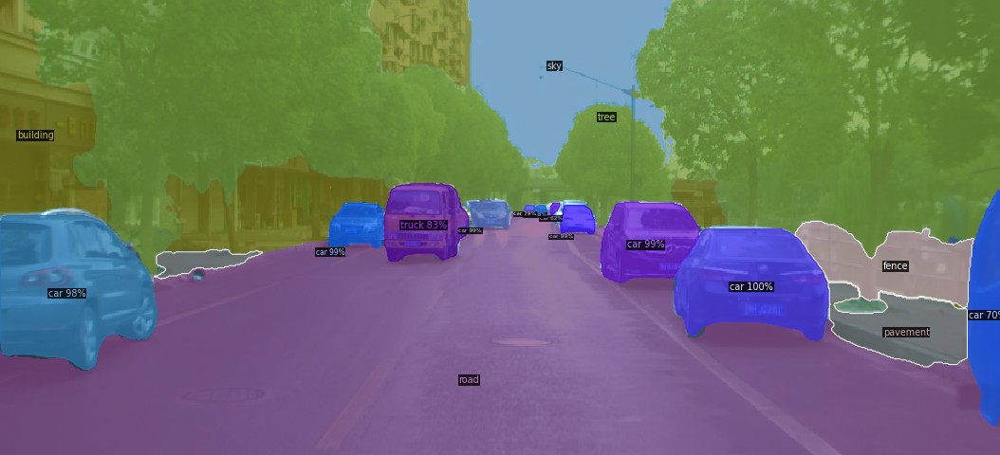

instance predictions


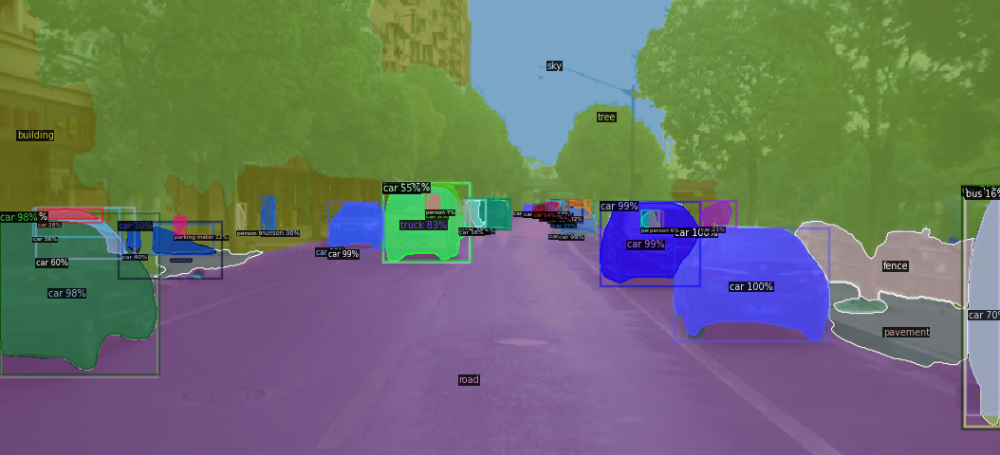

image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg
boundaries


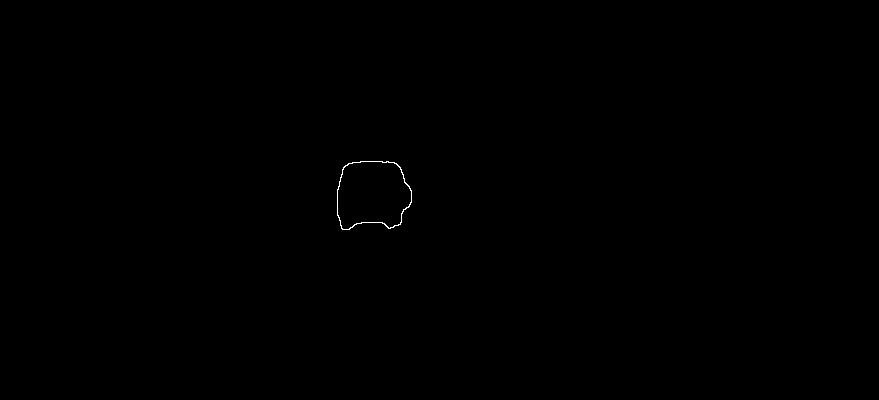

signature
centroid


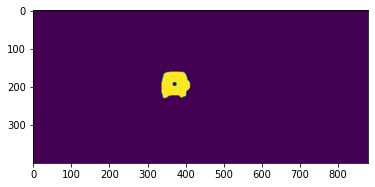

371 193


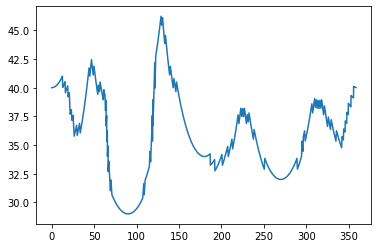

image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg


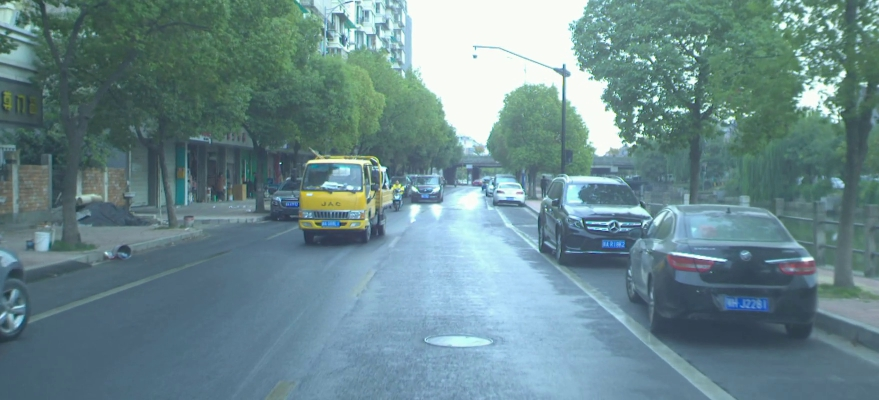

panoptic segmentations


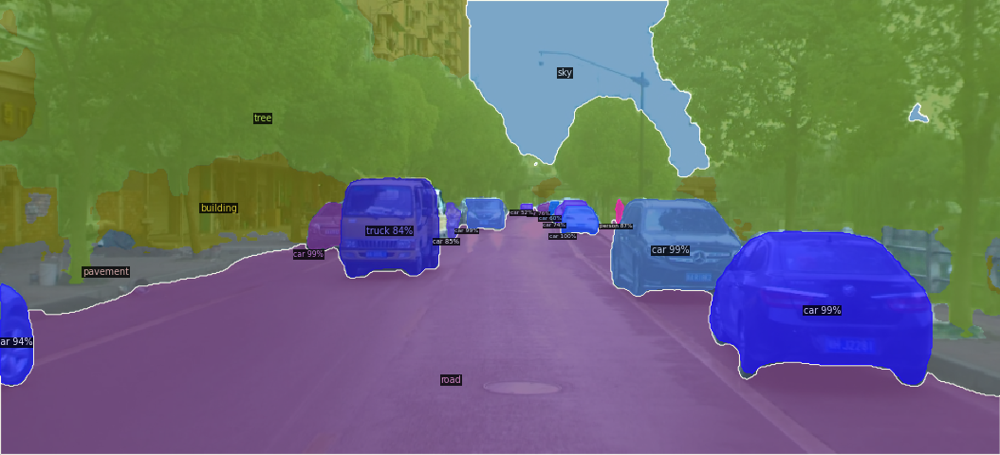

instance predictions


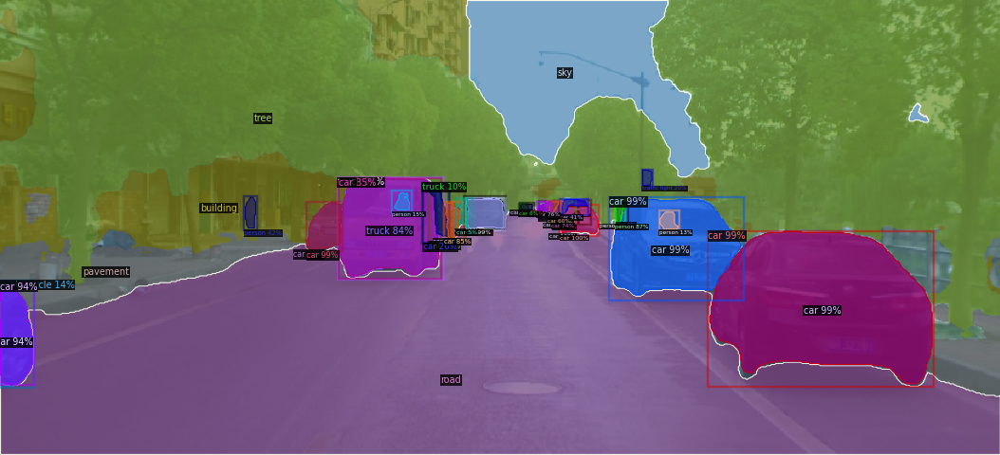

image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg
boundaries


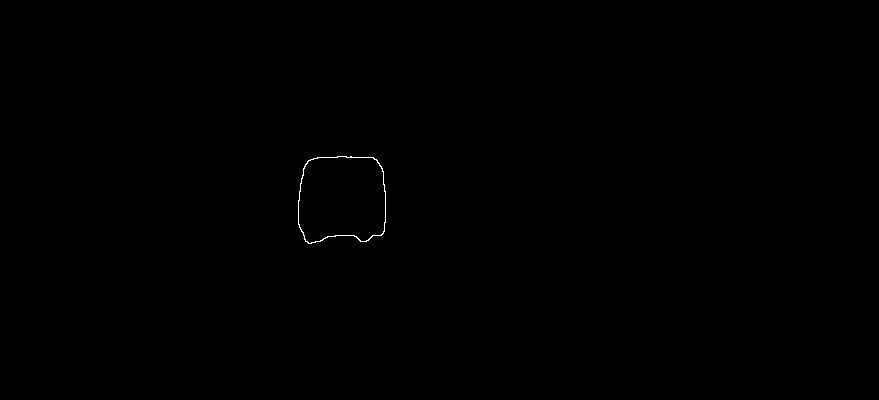

signature
centroid


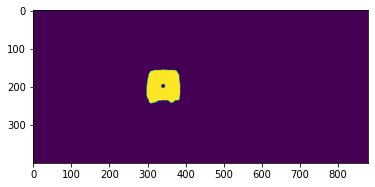

341 198


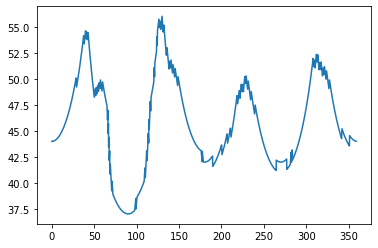

image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg


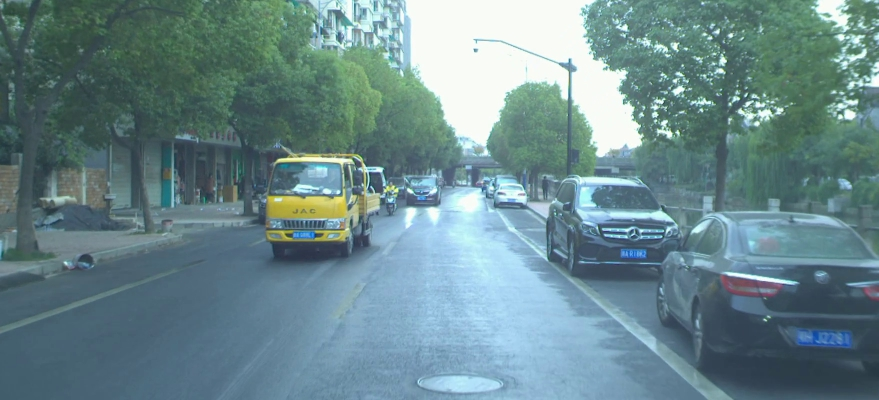

panoptic segmentations


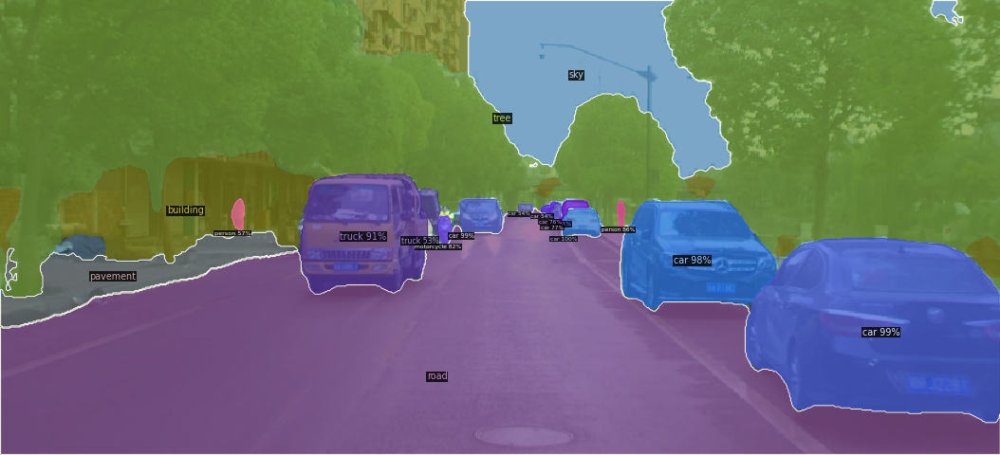

instance predictions


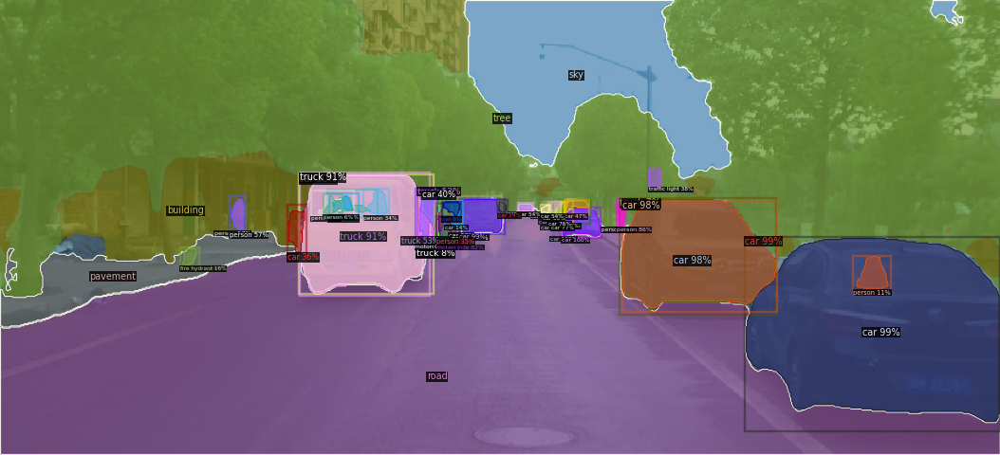

image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg
boundaries


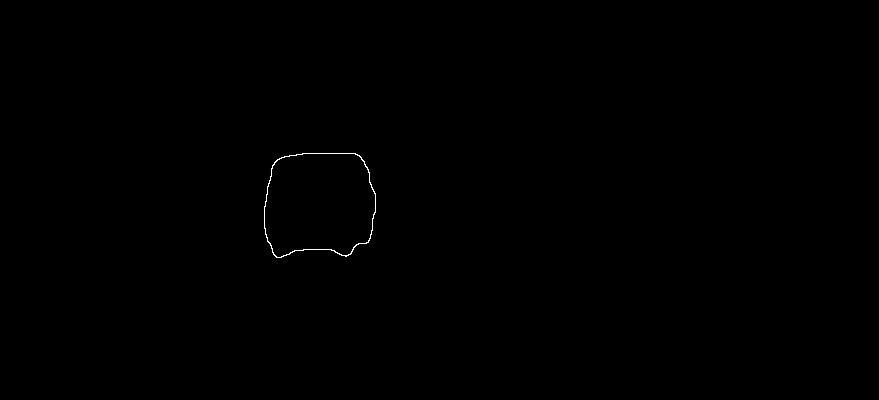

signature
centroid


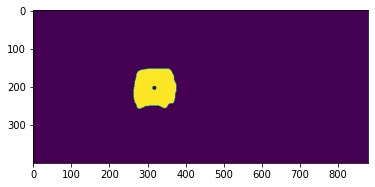

318 203


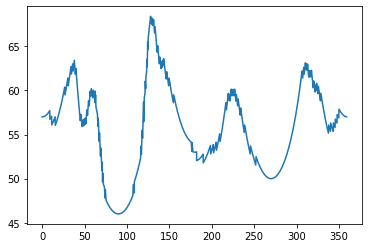

image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg


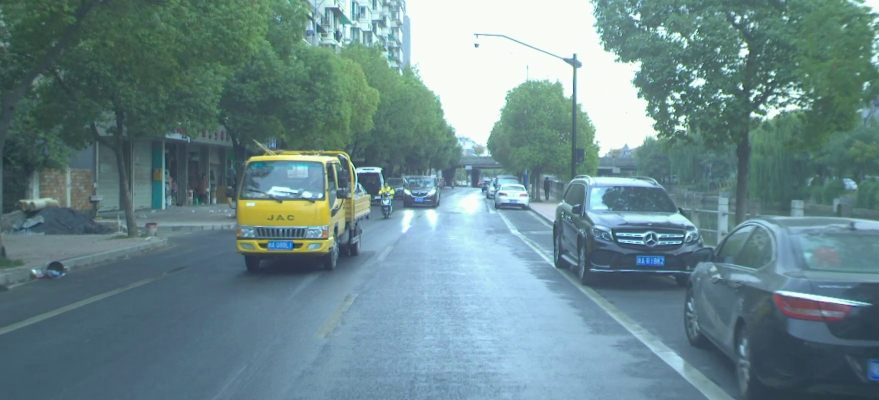

panoptic segmentations


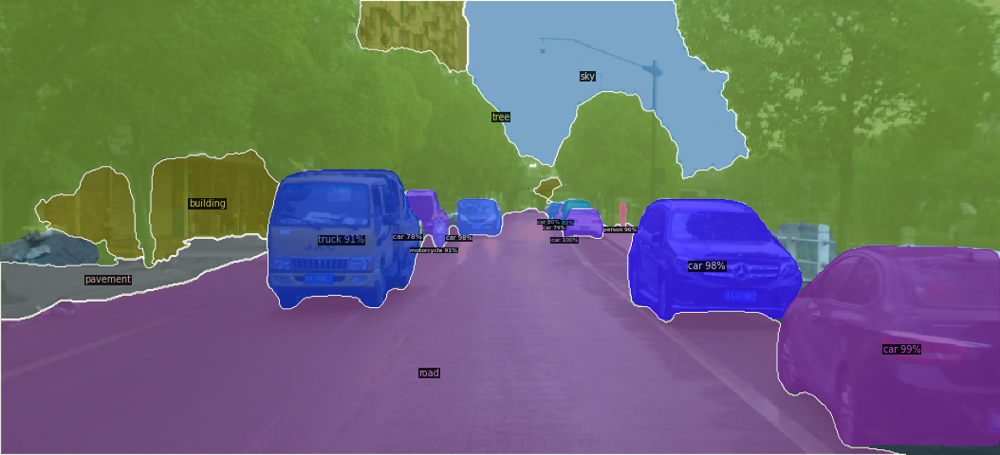

instance predictions


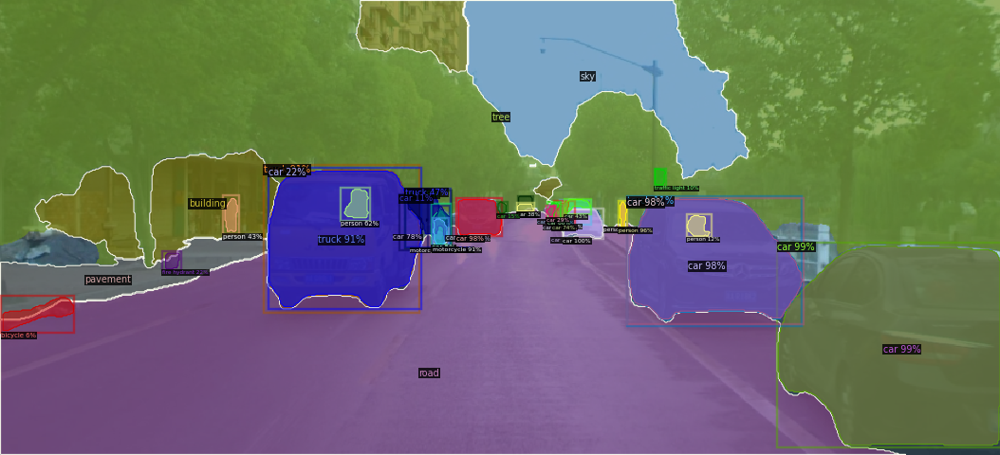

image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg
boundaries


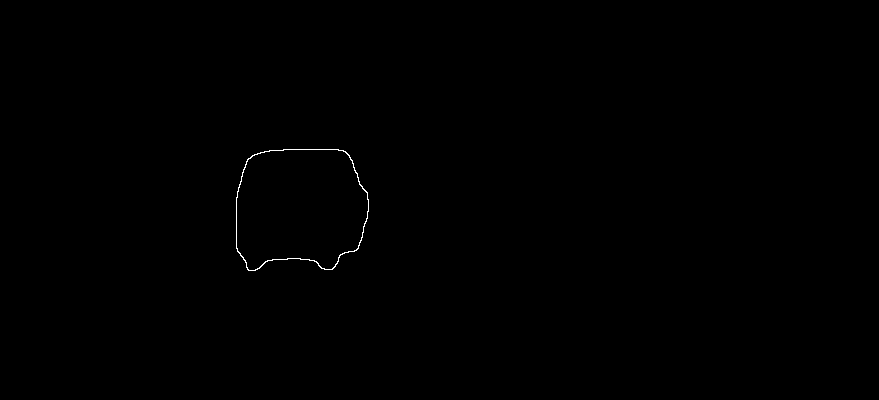

signature
centroid


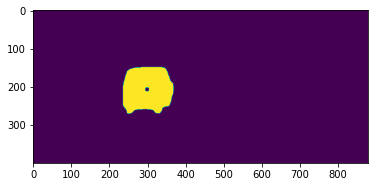

299 207


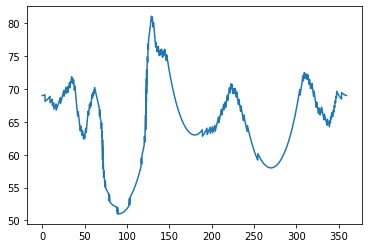

In [31]:
# Performing the same algorithm for several (5) images and comparing the chain code and boundary length (aka the order).

image_paths = ['image_1_2018-10-31-06-55-01_2018-10-31-07-00-50-232.jpg', 'image_2_2018-10-31-06-55-01_2018-10-31-07-00-50-730.jpg', 'image_3_2018-10-31-06-55-01_2018-10-31-07-00-51-229.jpg', 'image_4_2018-10-31-06-55-01_2018-10-31-07-00-51-529.jpg', 'image_5_2018-10-31-06-55-01_2018-10-31-07-00-51-729.jpg']
countour_ids = [9, 7, 8, 4, 6]

i = 0
for path in image_paths:
  print(path)
  _image = cv2.imread(path)
  cv2_imshow(_image)

  panoptic_and_instance_segmentation(_image)
  
  contour_id = countour_ids[i]
  i += 1
  _mask = get_mask_at_i(_image, contour_id)

  se = numpy.ones((3, 3), dtype=numpy.uint8)
  _eroded_mask = cv2.erode(_mask, se)

  _boundaries = _mask - _eroded_mask
  
  print(path)
  print('boundaries')
  cv2_imshow(_boundaries)


  print('signature')
  contours = get_countours(_image, False)
  calculate_signature(_mask, _boundaries, contours[contour_id])



  